## M5 Forecasting problem

 Estimation of 28 day point forecasts of the unit sales of various products at various time series levels sold in the USA by Walmart.

 The dataset involves **3,049** products classified in **3 product categories** (Foods, Household and Hobbies) having **7 departments** and sold across **10 stores** located in **3 states** (CA, TX and WI).

The hierarchy is as follows:
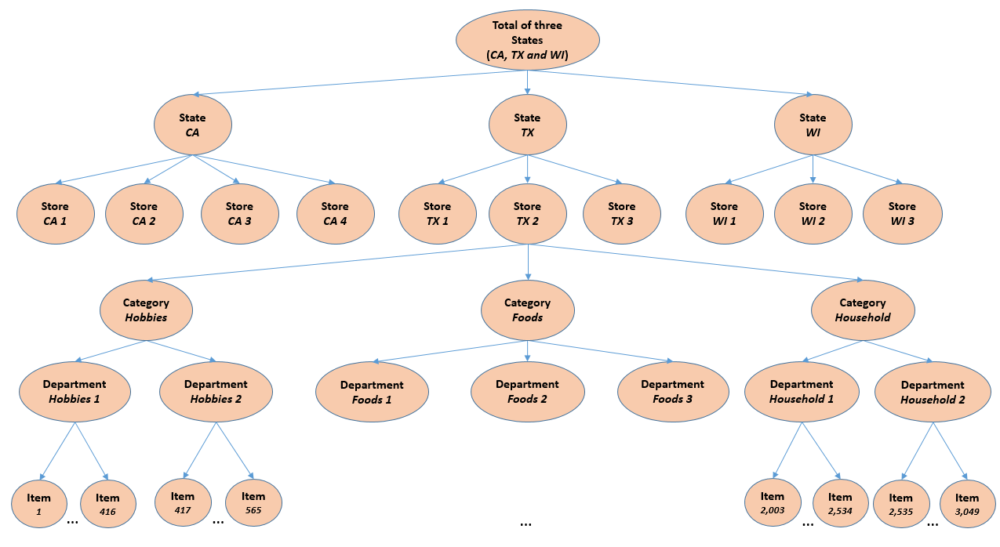




## Dataset description:

Historical data range: 2011-01-29 to 2016-04-24.
Test data: 28 days (2016-04-25 to 2016-06-19) or 4 weeks ahead.

### Inputs:

- Calendar file: Dates of the products sold
    * date: The date in a “y-m-d” format.
    * wm_yr_wk: The id of the week the date belongs to.
    * weekday: The type of the day (Saturday, Sunday, …, Friday).
    * wday: The id of the weekday, starting from Saturday.
    * month: The month of the date.
    * year: The year of the date.
    * event_name_1: If the date includes an event, the name of this event.* * event_type_1: If the date includes an event, the type of this event.
    * event_name_2: If the date includes a second event, the name of this event.
    * event_type_2: If the date includes a second event, the type of this event.
    * snap_CA, snap_TX, and snap_WI: A binary variable (0 or 1) indicating whether the stores of CA, TX or WI allow SNAP3 purchases on the examined date. 1 indicates that SNAP purchases are allowed.

- sell price file: Information about the price of products sold per state and date.
   * store_id: The id of the store where the product is sold.
   * item_id: The id of the product.
   * wm_yr_wk: The id of the week.
   * sell_price: The price of the product for the given week/store.

- sales train file: Contains the historical daily units sales data per product and store.
   * item_id: The id of the product.
   * dept_id: The id of the department the product belongs to.
   * cat_id: The id of the category the product belongs to.
   * store_id: The id of the store where the product is sold.
   * state_id: The State where the store is located.
   * d_1, d_2, …, d_i, … d_1941: The number of units sold at day i, starting from 2011-01-29.

# Table Contents:

## 1. Loading the data
## 2. Downstreaming the data
## 3. Data preprocessing
## 4. Exploratory data analysis(EDA)
   ##### 4.1 Trend analysis across various States and categories</ol>
   ##### 4.2  Bins of Sell Price at various categories (Food, Hobbies, Household)
   ##### 4.3 Units_sold, SKU count and Selling Price(max,min) per department
   ##### 4.4 Year-over-year states growth at Walmart, broken down by state (CA, TX, WI) and by store, across three categories
   ##### 4.5 Calendar-based representation of demand for the Hobbies category in 2013
   ##### 4.6 Sales during Special events, holidays across CA, WI and TX
   ##### 4.7  Different hierarchy levels for modelling
## 5. Feature Enginnering
   ##### 5.1 Conversion of daily data to weekly
## 6. Model Building
   ##### 6.1 Train-Test Split
   ##### 6.2 Model Selection(XGBoost, LightGBM)
   ##### 6.3 KPI Metrics (MAE, Bias, RMSE)

## 1. Loading the data

In [ ]:
# Importing libraries
# Data processing operations
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import numpy as np
from itertools import product

# Handling warnings
import warnings
warnings.filterwarnings('ignore')

# Loading datasets from google drive
import os
import glob
from google.colab import drive

drive.mount('/gdrive', force_remount=True)

# Clean the memory
import gc



Mounted at /gdrive


In [ ]:
# CSV files extracted into dictionary and loaded in respective dataframes
dataframes = {}
path = glob.glob(f"/gdrive/My Drive/M5 Forecasting dataset/*.csv")
for file in path:
  dataframes[file] = pd.read_csv(file)

# Storing the files in dataframes from dictionary dataframes
calendar = dataframes['/gdrive/My Drive/M5 Forecasting dataset/calendar.csv'] # datetime features
train = dataframes['/gdrive/My Drive/M5 Forecasting dataset/sales_train_validation.csv'] # train features
price = dataframes['/gdrive/My Drive/M5 Forecasting dataset/sell_prices.csv'] # selling price feature

In [ ]:
# Shape of the dataframes
print("Calendar:",calendar.shape)
print("Sales train:",train.shape)
print("Price:",price.shape)

Calendar: (1969, 14)
Sales train: (30490, 1919)
Price: (6841121, 4)


### 2. Downcasting (to improve memory performance)

In [ ]:
# Converting the columns dataframes to data type int16
for d in range(1,1913):
    col = 'd_' + str(d)
    train[col] = train[col].astype(np.int16)

In [ ]:
# Downcasting
train_bd = np.round(train.memory_usage().sum()/(1024*1024),1)
calendar_bd = np.round(calendar.memory_usage().sum()/(1024*1024),1)
price_bd = np.round(price.memory_usage().sum()/(1024*1024),1)


cols = train.dtypes.index.tolist()
types = train.dtypes.values.tolist()
train.dtypes.index, train.dtypes.values

(Index(['id', 'item_id', 'dept_id', 'cat_id', 'store_id', 'state_id', 'd_1',
        'd_2', 'd_3', 'd_4',
        ...
        'd_1904', 'd_1905', 'd_1906', 'd_1907', 'd_1908', 'd_1909', 'd_1910',
        'd_1911', 'd_1912', 'd_1913'],
       dtype='object', length=1919),
 array([dtype('O'), dtype('O'), dtype('O'), ..., dtype('int16'),
        dtype('int16'), dtype('int64')], dtype=object))

In [ ]:
def downcast(df):
    cols = df.dtypes.index.tolist()
    types = df.dtypes.values.tolist()
    for i, t in enumerate(types):
        if 'int' in str(t):
            if df[cols[i]].min() > np.iinfo(np.int8).min and df[cols[i]].max() < np.iinfo(np.int8).max:
                df[cols[i]] = df[cols[i]].astype(np.int8)
            elif df[cols[i]].min() > np.iinfo(np.int16).min and df[cols[i]].max() < np.iinfo(np.int16).max:
                df[cols[i]] = df[cols[i]].astype(np.int16)
            elif df[cols[i]].min() > np.iinfo(np.int32).min and df[cols[i]].max() < np.iinfo(np.int32).max:
                df[cols[i]] = df[cols[i]].astype(np.int32)
            else:
                df[cols[i]] = df[cols[i]].astype(np.int64)

        elif 'float' in str(t):
            if df[cols[i]].min() > np.finfo(np.float16).min and df[cols[i]].max() < np.finfo(np.float16).max:
                df[cols[i]] = df[cols[i]].astype(np.float16)
            elif df[cols[i]].min() > np.finfo(np.float32).min and df[cols[i]].max() < np.finfo(np.float32).max:
                df[cols[i]] = df[cols[i]].astype(np.float32)
            else:
                df[cols[i]] = df[cols[i]].astype(np.float64)

        elif t == object:
            if cols[i] == 'date':
                df[cols[i]] = pd.to_datetime(df[cols[i]], format='%Y-%m-%d')
            else:
                df[cols[i]] = df[cols[i]].astype('category')
    return df

train = downcast(train)
price = downcast(price)
calendar = downcast(calendar)

In [ ]:
# Dataframes' memory after downcasting
train_ad = np.round(train.memory_usage().sum()/(1024*1024),1)
calendar_ad = np.round(calendar.memory_usage().sum()/(1024*1024),1)
prices_ad = np.round(price.memory_usage().sum()/(1024*1024),1)

In [ ]:
dic = {'DataFrame':['train','calendar','price'],
       'Before downcasting':[train_bd,calendar_bd,price_bd],
       'After downcasting':[train_ad,calendar_ad,prices_ad]}

# Plot to display the memory usage before and after downcast
memory = pd.DataFrame(dic)
memory = pd.melt(memory, id_vars='DataFrame',
                 var_name = 'Status', value_name = 'Memory (MB)') ; memory
memory.sort_values(by='Memory (MB)', inplace=True) ; memory
fig = px.bar(memory, x='DataFrame', y='Memory (MB)', color='Status',
             barmode='group', text='Memory (MB)')
fig.update_traces(texttemplate='%{text} MB', textposition='outside')
fig.update_layout(template='seaborn',title='Effect of Downcasting')

## 3. Data preprocessing

In [ ]:
# Unpivot of train and val dataframe from wide 'd' format to long 'd' format
train = pd.melt(train, id_vars=['id','item_id','dept_id','cat_id','store_id','state_id'],
        var_name='d',value_name='units_sold').dropna()
train = train.merge(right=calendar,on=['d']) # merge with calendar data
train = train.sort_values(by='date',ascending=True)

## 4. Exploratory Data Analysis(EDA)

### 4.1 Trend analysis across various States and categories

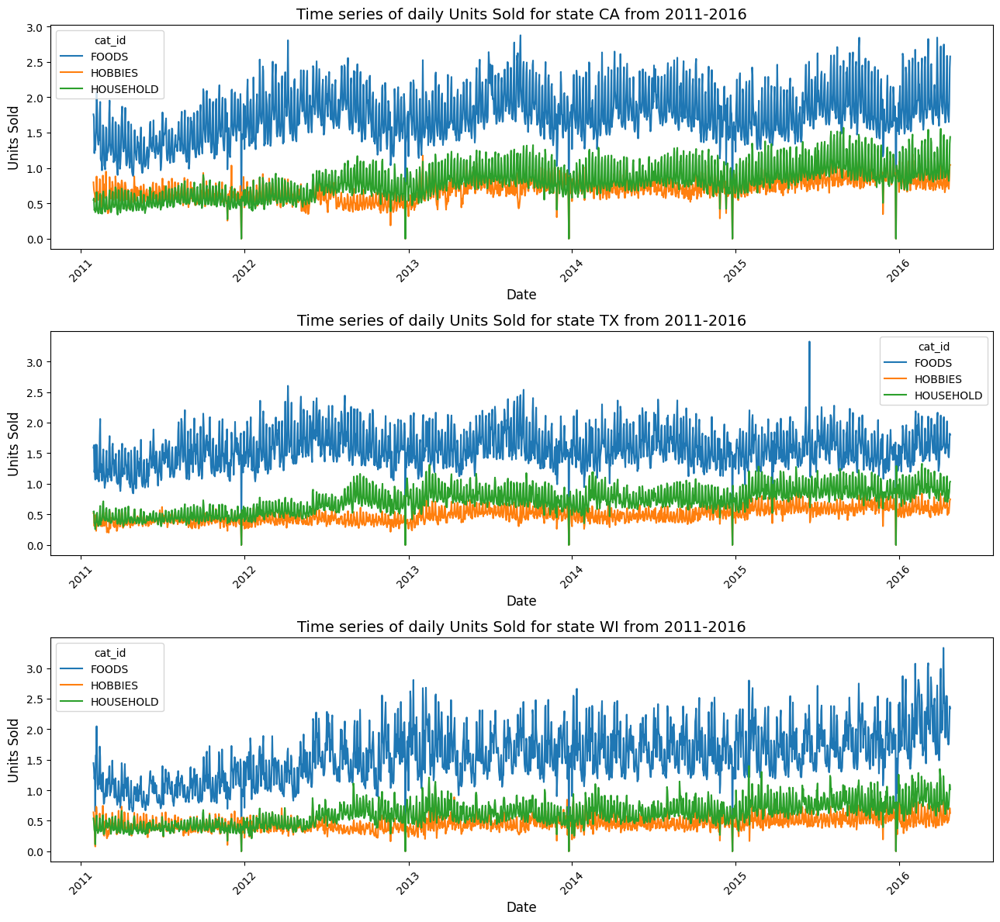

In [ ]:
""""
Trend analysis across various States and categories
Subplots to visualize different states (CA, TX, WI) and categories (FOODS, HOBBIES, HOUSEHOLD)
"""
def trend_analysis(dict_item):
    fig, axes = plt.subplots(3, 1, figsize=(13, 12))

    for ax, (state, df) in zip(axes, dict_item.items()):
        sns.lineplot(data=df, x='date', y='units_sold', hue='cat_id',ax=ax,errorbar=None)

        # Set labels and title
        ax.set_title(f'Time series of daily Units Sold for state {state} from 2011-2016', fontsize=14)
        ax.set_xlabel('Date', fontsize=12)
        ax.set_ylabel('Units Sold', fontsize=12)

        ax.tick_params(axis='x', rotation=45)


    plt.tight_layout()
    plt.show()

# dictionary to store data of different states
states_dict = {'CA':train[train['state_id'] == 'CA'],
 'TX': train[train['state_id'] == 'TX'],
 'WI':train[train['state_id'] == 'WI']}

# function to plot trend_analysis
trend_analysis(states_dict)

**Observations:**

* Sales in the FOODS category are higher compared to HOUSEHOLD and HOBBIES categories.

* Seasonal peaks are evident in FOODS across all three states, likely driven by key sales periods such as holidays and promotions. Notably, there was an unusual sales spike in 2015 for Texas (TX).

* A noticeable dip occurs at the end of each year, most likely due to the Christmas and New Year holiday period.

* Sales tend to be higher during the summer months.

* In 2012, there was a clear uptrend in sales across all categories, with seasonality patterns remaining consistent.




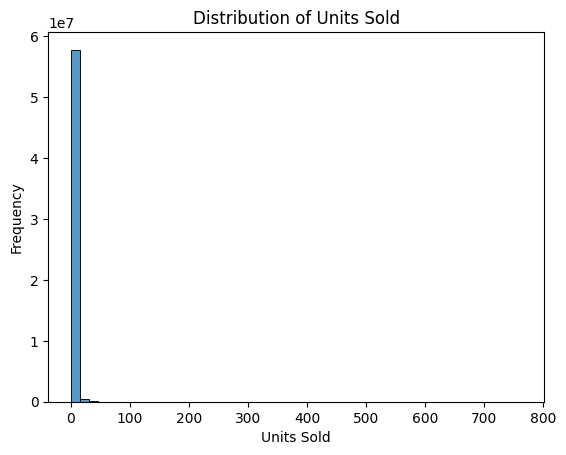

In [ ]:
# Distribution of units_sold
sns.histplot(train['units_sold'],bins=50)
plt.title('Distribution of Units Sold')
plt.xlabel('Units Sold')
plt.ylabel('Frequency')
plt.show()

The units_sold follows a right-tail distribution where many of the values are around 0 an indication that the sales can have lot of zeros and follow an intermittent pattern.

### 4.2 Price ranges for different categories (FOODS, HOBBIES and HOUSEHOLD)

In [ ]:
"""
Function to create bins and labels based on the sell_price for each category.
Food: $(0-6)[Low],$(6-12)[Medium],$(12-19)[High]
Hobbies: $(0-10)[Low],$(10-20)[Medium],$(20-30)[High]
Household: $(0-35)[Low],$(35-71)[Medium],$(71-107)[High]
"""
def create_bins_for_category(group, num_bins=3):
    group['sell_price'] = group['sell_price'].astype('float32')
    min_val = group['sell_price'].min()
    max_val = group['sell_price'].max()

    # Create "Low", "Medium", "High" bins based on the min/max values
    bins = pd.cut(group['sell_price'], bins=num_bins,labels=['Low','Medium','High'], include_lowest=True)

    return bins

# Category, department and price_bin columns in price dataframe
price['cat_id'] = price['item_id'].str.split('_').str[0]
price['dept_id'] = price['item_id'].str.split('_').str[:2].str.join('_')
price['price_bin'] = price.groupby('cat_id',group_keys=False).apply(create_bins_for_category)

In [ ]:
"""
Sell prices labelled in the above function are displayed in the format of a pivot table
"""
categories = []
low_perc = []
medium_perc = []
high_perc = []

for category in price['cat_id'].unique():

    categories.append(category)
    value_counts = price[price['cat_id'] == category]['price_bin'].value_counts()
    percentages = (round(price[price['cat_id'] == category]['price_bin'].value_counts(normalize=True) * 100,4))

    # Append values or 0 if the bin does not exist

    low_perc.append(percentages.get('Low', 0))
    medium_perc.append(percentages.get('Medium', 0))
    high_perc.append(percentages.get('High', 0))

price_cat_result = pd.DataFrame({
    'Category': categories,

    'Low sell price(%)': low_perc,

    'Medium sell price(%)': medium_perc,

    'High sell price(%)': high_perc
})

price_cat_result


,Category,Low sell price(%),Medium sell price(%),High sell price(%)
0,HOBBIES,85.0992,13.8632,1.0376
1,HOUSEHOLD,99.9978,0.0021,0.0001
2,FOODS,92.6192,7.0265,0.3543


Sell prices for categories Hobbies, Household and Foods are low as the products are frequently purchased by customers. In the hobbies category,13% of the products are medium priced, while 7% fall in the medium price in the foods category.

### 4.3 Distribution of #products, overall sales and range of sell price per department

In [ ]:
product_count = train.groupby(['dept_id'])['item_id'].nunique().reset_index()
product_count.rename(columns={'item_id':'no_of_products'},inplace=True)

dept_sales_count = train.groupby(['dept_id'])['units_sold'].sum().reset_index()
dept_sales_count.rename(columns={'units_sold':'Overall_dept_sales'},inplace=True)

price_statistics = price.groupby('dept_id').agg(min_sell_price=('sell_price','min'),
                               max_sell_price=('sell_price','max')
                              ).reset_index()


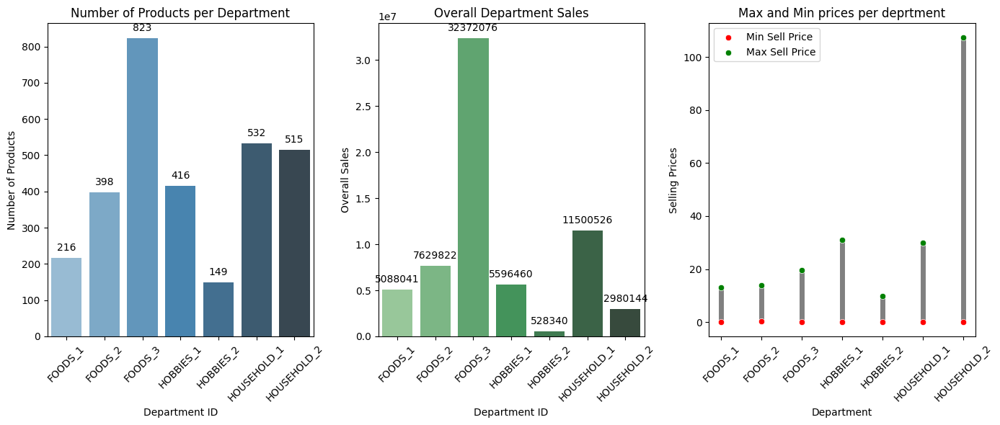

In [ ]:
dept_prod_sales = pd.merge(product_count,dept_sales_count,how='inner',on='dept_id')

# Set the figure size
plt.figure(figsize=(14, 6))

# Bar plot for number of products
plt.subplot(1, 3, 1)  # 1 row, 2 columns, first subplot
b1 = sns.barplot(data=dept_prod_sales, x='dept_id', y='no_of_products', palette='Blues_d')
plt.title('Number of Products per Department')
plt.xlabel('Department ID')
plt.ylabel('Number of Products')
plt.xticks(rotation=45)

for p in b1.patches:
    b1.annotate(f'{int(p.get_height())}',
                        (p.get_x() + p.get_width() / 2., p.get_height()),
                        ha='center', va='bottom',
                        fontsize=10, color='black',
                        xytext=(0, 5),  # 5 points vertical offset
                        textcoords='offset points')


# Bar plot for overall department sales
plt.subplot(1, 3, 2)  # 1 row, 2 columns, second subplot
b2 = sns.barplot(data=dept_prod_sales, x='dept_id', y='Overall_dept_sales', palette='Greens_d')
for p in b2.patches:
    b2.annotate(f'{int(p.get_height())}',
                        (p.get_x() + p.get_width() / 2., p.get_height()),
                        ha='center', va='bottom',
                        fontsize=10, color='black',
                        xytext=(0, 5),  # 5 points vertical offset
                        textcoords='offset points')

plt.title('Overall Department Sales')
plt.xlabel('Department ID')
plt.ylabel('Overall Sales')
plt.xticks(rotation=45)

# Bar plot for overall department price statitics
plt.subplot(1, 3, 3)
#sns.boxplot(data=price_statistics, x='dept_id', y='Price', hue='Statistic')
plt.vlines(x=price_statistics['dept_id'], ymin=price_statistics['min_sell_price'], ymax=price_statistics['max_sell_price'], color='grey', linewidth=5)
sns.scatterplot(x=price_statistics['dept_id'],
                y=price_statistics['min_sell_price'],
                color='red',
                label='Min Sell Price',
                zorder=5)
sns.scatterplot(x=price_statistics['dept_id'],
                y=price_statistics['max_sell_price'],
                color='green',
                label='Max Sell Price',
                zorder=5)


plt.title('Max and Min prices per deprtment')
plt.xlabel('Department')
plt.ylabel('Selling Prices')
plt.xticks(rotation=45)

plt.tight_layout()


plt.show()

* The FOODS_3 department has the most products and the highest sales overall, with all prices below $20.
* The Household department offers a large number of higher-priced products, but its sales are lower compared to FOODS.
* The Hobbies category has the lowest sales of the three departments

In [ ]:
# Let's consider products in FOODS_1 catgory

def get_demand_metrics(df, date_column):
    df_dmetrics = df.groupby('item_id').agg(
        date_min=(date_column, 'min'),
        date_max=(date_column, 'max'),
        n_demands=(date_column, 'nunique'),
        demand_std=('units_sold', 'std'),
        demand_mean=('units_sold', 'mean'))

    df_dmetrics['cv2'] = np.power(df_dmetrics['demand_std'] / df_dmetrics['demand_mean'], 2.0)

    time_delta = df_dmetrics['date_max'] - df_dmetrics['date_min']
    if pd.api.types.is_numeric_dtype(time_delta):
        df_dmetrics['adi'] = time_delta / df_dmetrics['n_demands']
    else:
        df_dmetrics['adi'] = time_delta.dt.days / df_dmetrics['n_demands']

    conditions = [
        (df_dmetrics['cv2'] <= 0.49) & (df_dmetrics['adi'] <= 1.32),
        (df_dmetrics['cv2'] <= 0.49) & (df_dmetrics['adi'] >  1.32),
        (df_dmetrics['cv2'] >  0.49) & (df_dmetrics['adi'] <= 1.32)
    ]
    choices = ['smooth', 'intermittent', 'erratic']
    df_dmetrics['type'] = np.select(conditions, choices,default='lumpy')

    return df_dmetrics

def plot_demand_type(df_demand_metrics):
    fig, ax = plt.subplots(1, figsize=(6, 5))
    ax.scatter(df_demand_metrics['cv2'], df_demand_metrics['adi'], alpha = 0.5)
    ax.axhline(1.32, linestyle='--', color='k')
    ax.axvline(0.49, linestyle='--', color='k')
    ax.set_xlim([-0.1, 1.5])
    ax.set_xlabel('CV2')
    ax.set_ylabel('ADI')
    plt.show()

demand_results = []
# demand_type = []
for dept in train['dept_id'].unique():
    dept_df = train[train['dept_id'] == dept]
    df_dmetrics = get_demand_metrics(dept_df, 'date')

    d_types = {
            'Department': dept,
            'Demand_type': df_dmetrics['type'].value_counts().to_dict()
        }

    demand_results.append(d_types)

demand_df = pd.DataFrame(demand_results)

In [ ]:
demand_df

,Department,Demand_type
0,HOBBIES_1,"{'lumpy': 2633, 'erratic': 416}"
1,FOODS_2,"{'lumpy': 2651, 'erratic': 398}"
2,FOODS_1,"{'lumpy': 2833, 'erratic': 216}"
3,FOODS_3,"{'lumpy': 2226, 'erratic': 817, 'smooth': 6}"
4,HOUSEHOLD_1,"{'lumpy': 2517, 'erratic': 532}"
5,HOUSEHOLD_2,"{'lumpy': 2534, 'erratic': 515}"
6,HOBBIES_2,"{'lumpy': 2900, 'erratic': 149}"


Most of the items fall in the Lumpy and erratic category and one FOODS_3 has demands belonging to the smooth category.

### 4.4 Year-over-year(YoY) states growth at Walmart, broken down by state (CA, TX, WI) for three categories

In [ ]:
"""
Function to calculate the percentage change in sales w.r.t state, category, store_id and year from 2011 to 2015
"""

def sales_growth_rate(df,*cols):
    cols = list(cols)

    year_s = df.groupby(['state_id','cat_id']+cols+['d'])['units_sold'].sum().reset_index()
    year_s = year_s.merge(right=calendar,on='d')
    year_s = year_s[~(year_s['year']==2016)]
    year_s = pd.DataFrame(year_s.groupby(['state_id','cat_id']+cols+['year'])['units_sold'].sum()).reset_index()
    year_s['yearly_growth_rate']=year_s.groupby(['state_id','cat_id']+cols)['units_sold'].pct_change() * 100
    return year_s

state_growth_rate_yearly = sales_growth_rate(train)
state_store_growth_rate_yearly = sales_growth_rate(train,'store_id')


In [ ]:
state_growth_rate_yearly

,state_id,cat_id,year,units_sold,yearly_growth_rate
0,CA,FOODS,2011,2710198,NaN
1,CA,FOODS,2012,3743250,38.117215
2,CA,FOODS,2013,3815744,1.936659
3,CA,FOODS,2014,3838839,0.605255
4,CA,FOODS,2015,3782000,-1.480630
5,CA,HOBBIES,2011,474721,NaN
6,CA,HOBBIES,2012,460769,-2.938989
7,CA,HOBBIES,2013,604911,31.282921
8,CA,HOBBIES,2014,595458,-1.562709
9,CA,HOBBIES,2015,686872,15.351880


  state_id cat_id  year  units_sold  yearly_growth_rate
0       CA  FOODS  2011     2710198                 NaN
1       CA  FOODS  2012     3743250           38.117215
2       CA  FOODS  2013     3815744            1.936659
3       CA  FOODS  2014     3838839            0.605255
4       CA  FOODS  2015     3782000           -1.480630
state_id


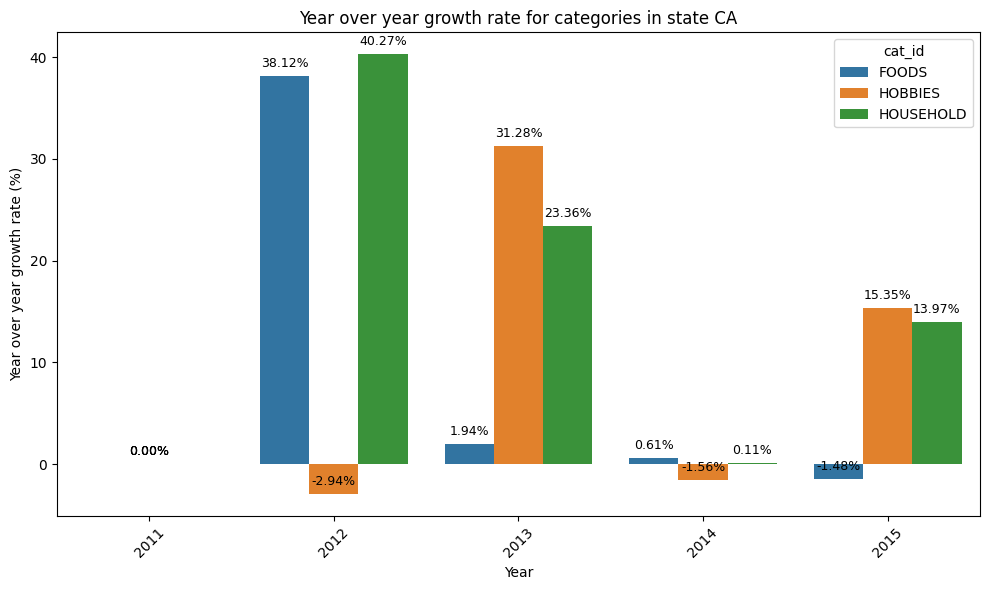

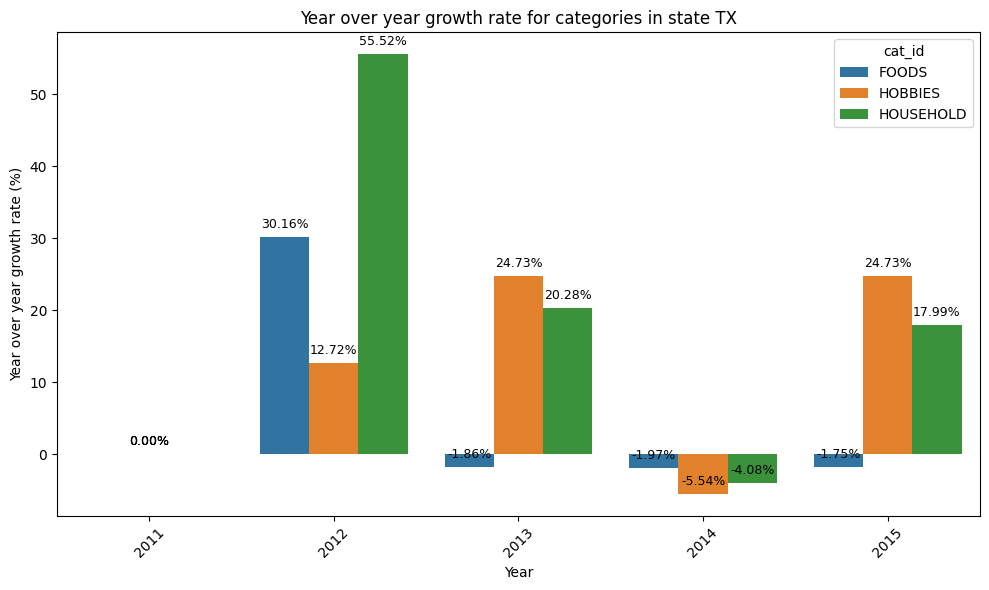

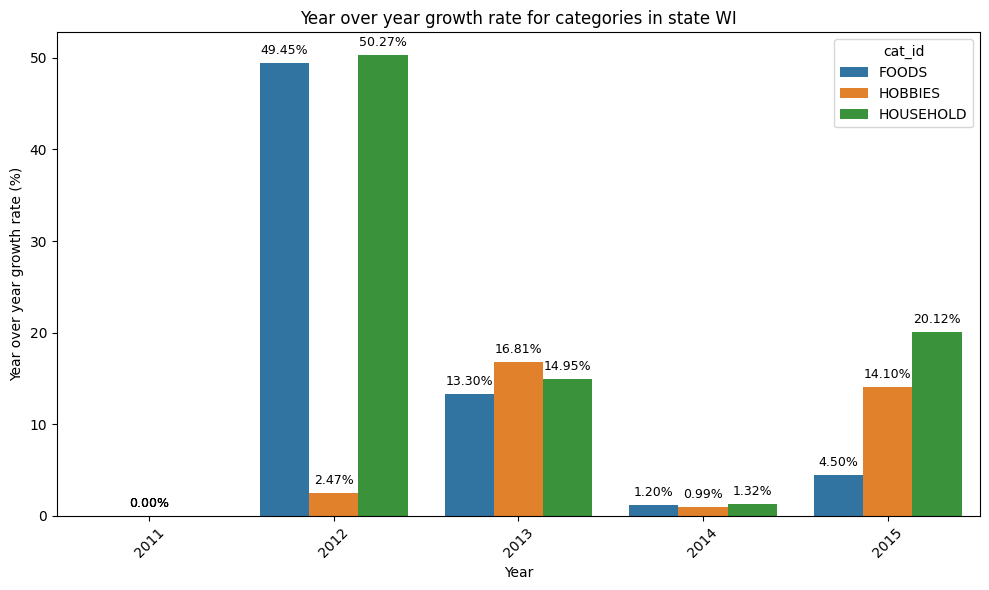

In [ ]:
# Visualization of year-over-year sales% across States
"""
Function to visualize the year-over-year growth%
"""
#col=['state_id']
def yoy_visualization(df, col):

    for col1 in df[col].unique():

       d1 = df[(df[col] == col1)]
       #print(d1.head())
       plt.figure(figsize=(10, 6))

       # Bar plot for comparing the yearly growth
       ax = sns.barplot(data=d1, x='year', y='yearly_growth_rate', hue='cat_id')
       plt.title(f"Year over year growth rate for categories in state {col1}")
       plt.xlabel("Year")
       plt.ylabel("Year over year growth rate (%)")

       plt.xticks(rotation=45)

       for p in ax.patches:
           ax.annotate(f'{p.get_height():.2f}%',
                                (p.get_x() + p.get_width() / 2., p.get_height()),
                                ha='center', va='center', xytext=(0, 9), textcoords='offset points', fontsize=9)


       plt.tight_layout()
    plt.show()

yoy_visualization(state_growth_rate_yearly,'state_id')

**CA:**

* Foods and Household started with positive growth in 2012, but while Foods experienced a sharp decline in the following years, Household saw a slower, yet still positive, decline.
* Hobbies showed alternating growth across the years.

**TX:**

* 2014 saw a significant decline across all categories.
* Hobbies and Household maintained positive growth momentum afterward.

**WI:**

* Positive growth remained consistent over the years, except for a decline in 2014.

## 4.5 Year-over-year(YoY) states growth at Walmart, broken down by store (CA_1, CA_2, CA_3, CA_4, TX_1, TX_2, TX_3, WI_1, WI_2, WI_3) for three categories

  state_id cat_id store_id  year  units_sold  yearly_growth_rate
0       CA  FOODS     CA_1  2011      754613                 NaN
1       CA  FOODS     CA_1  2012     1050355           39.191215
2       CA  FOODS     CA_1  2013     1085209            3.318307
3       CA  FOODS     CA_1  2014     1101681            1.517864
4       CA  FOODS     CA_1  2015     1055433           -4.197948
store_id


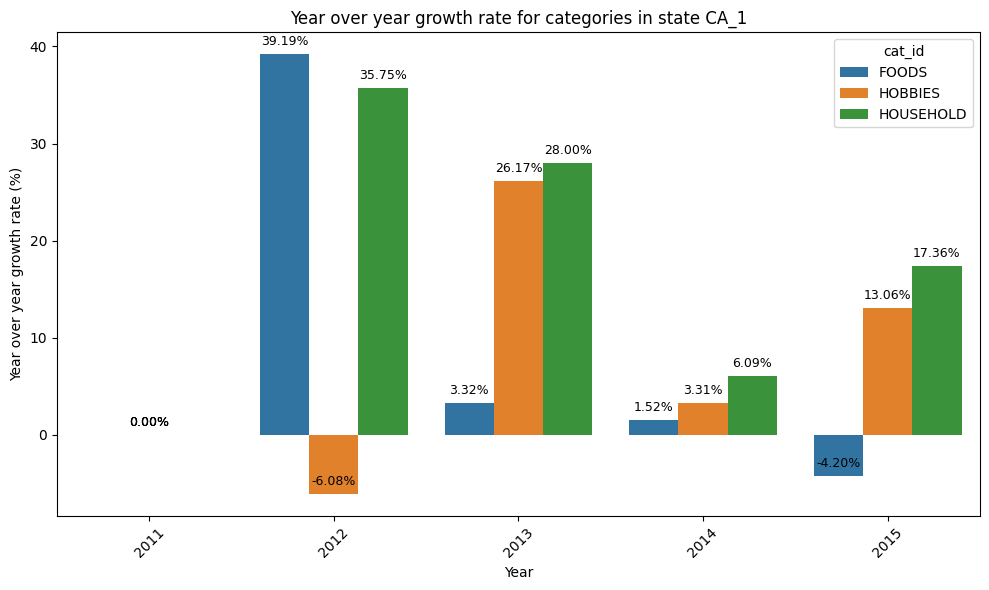

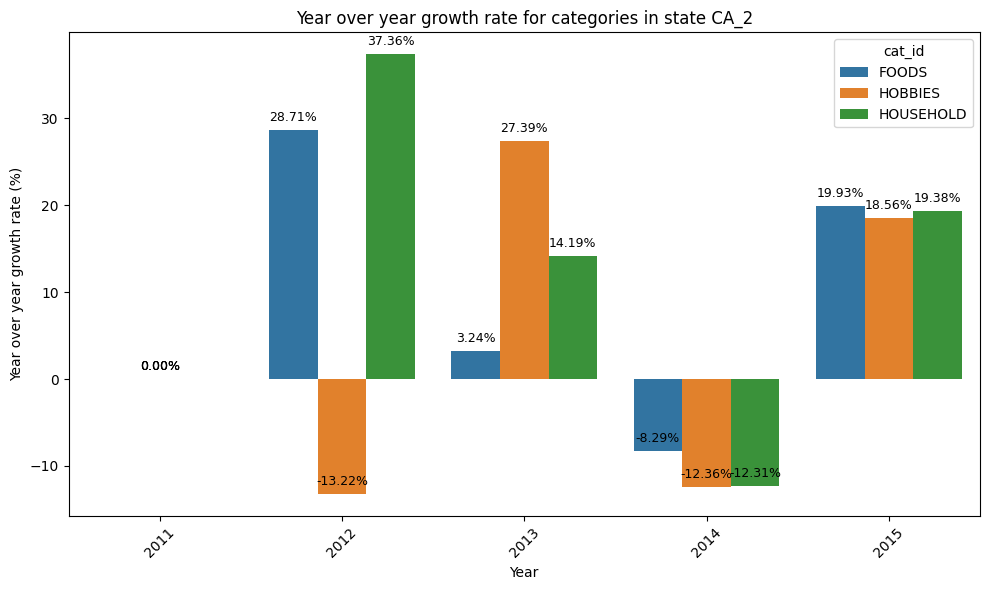

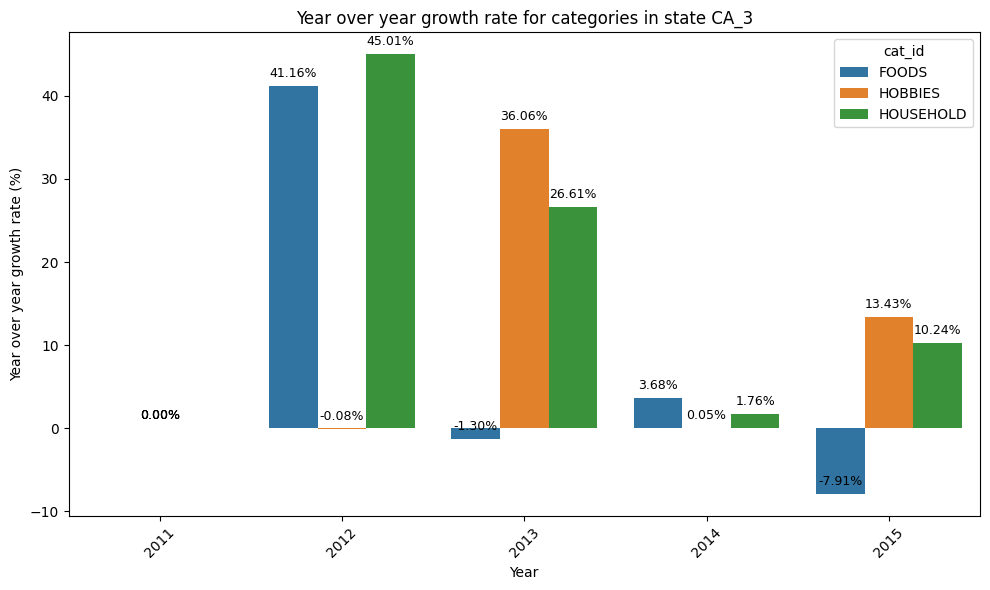

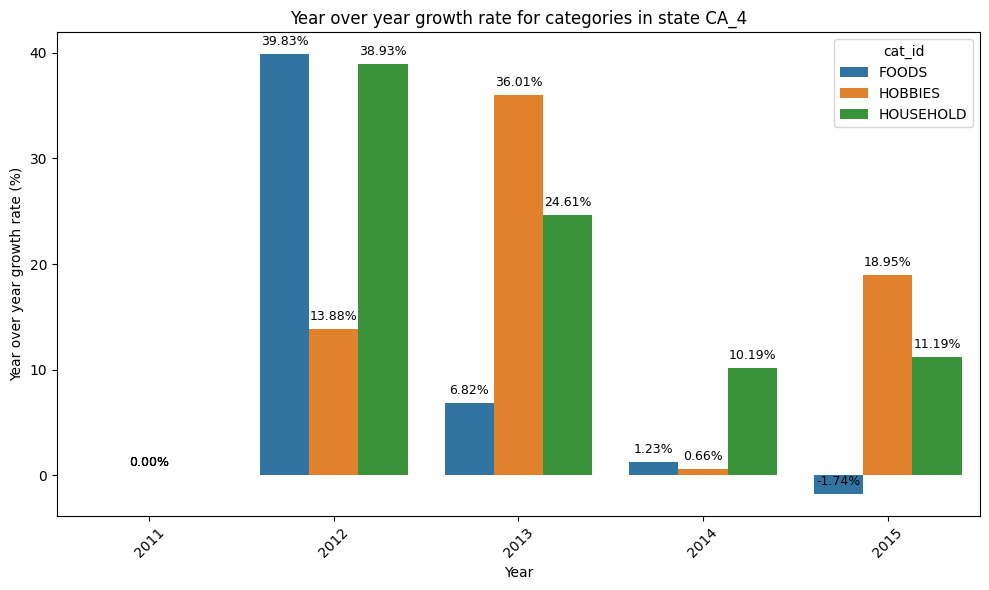

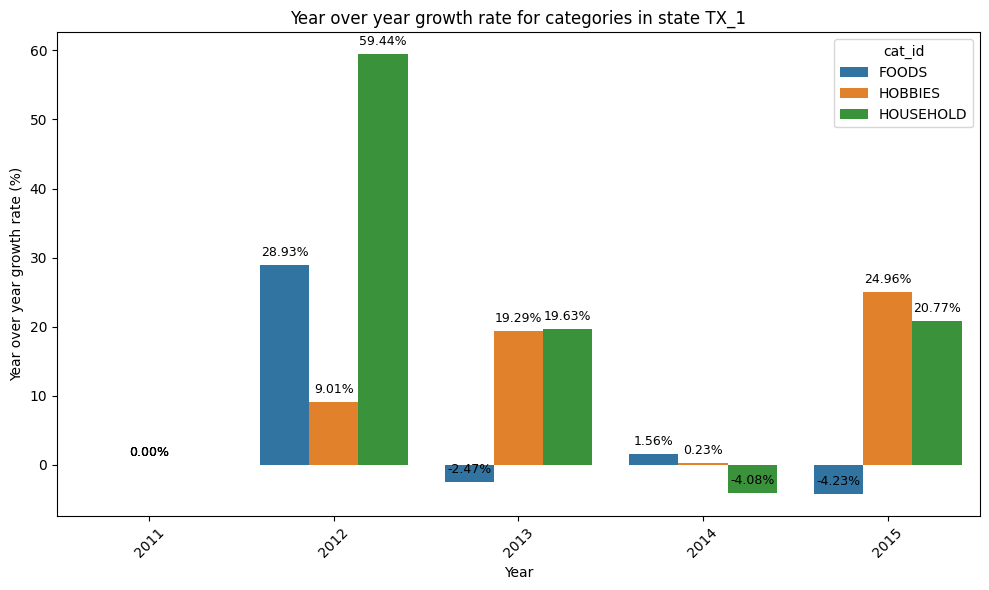

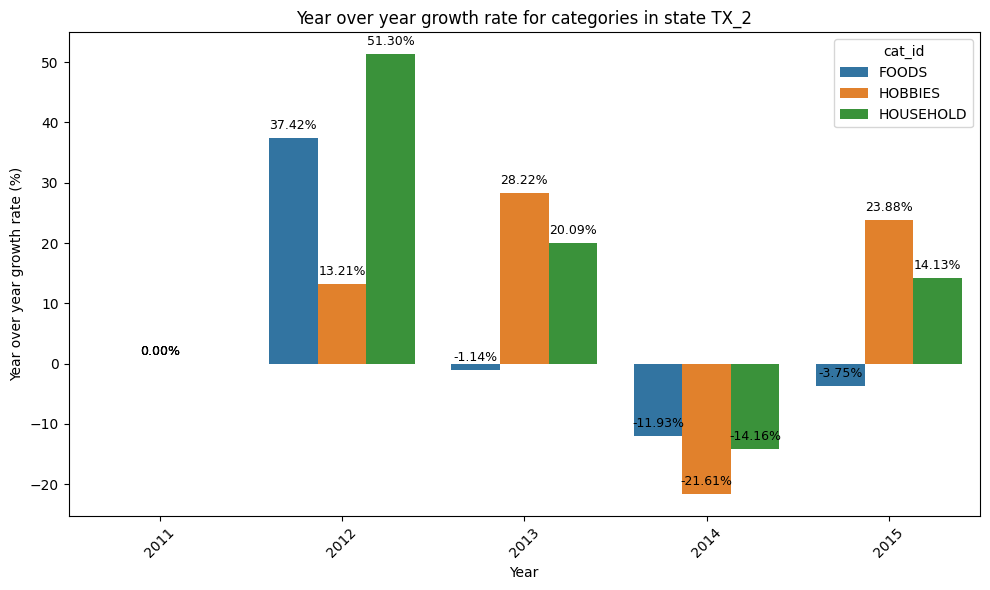

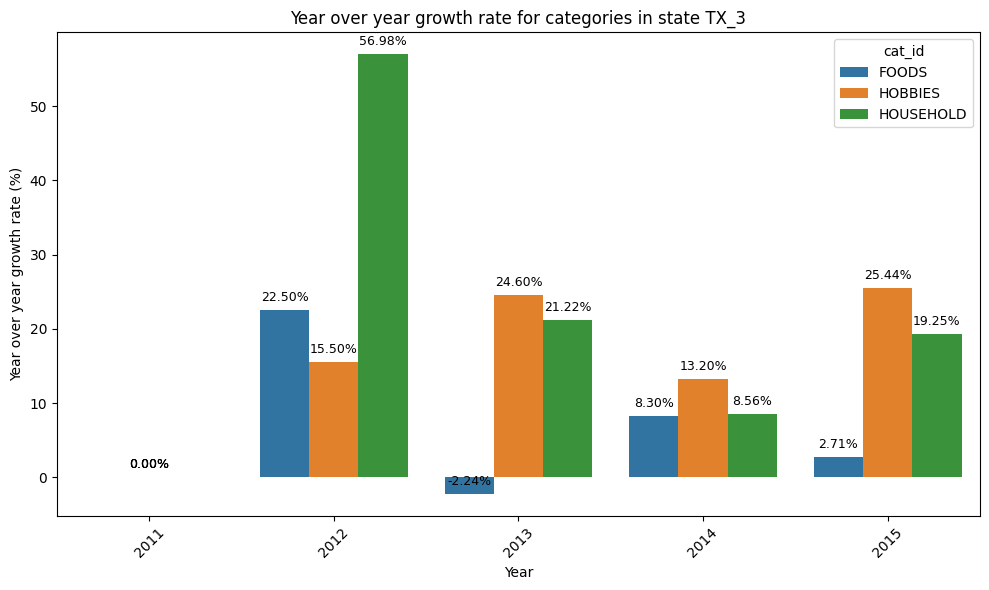

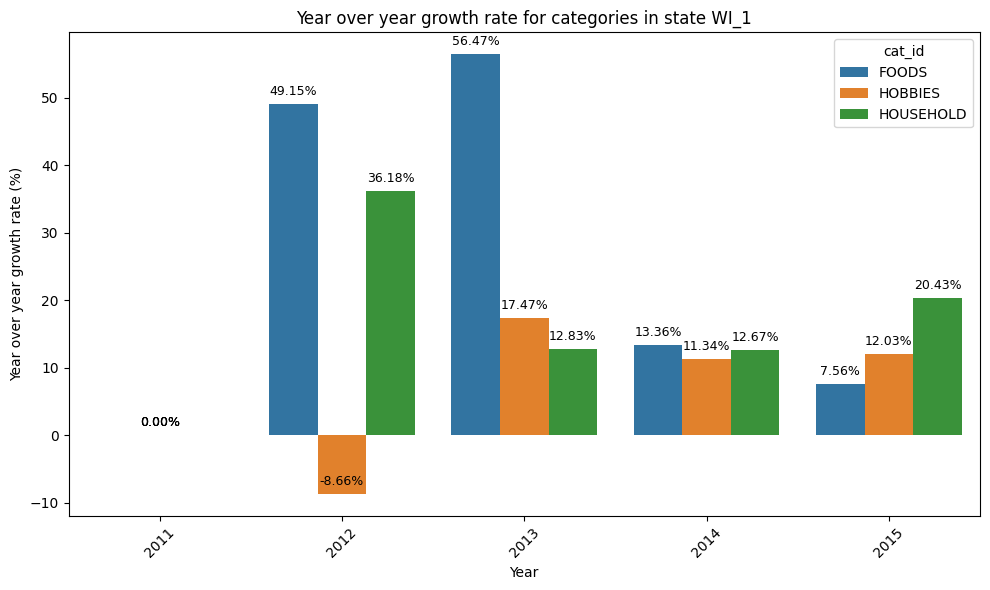

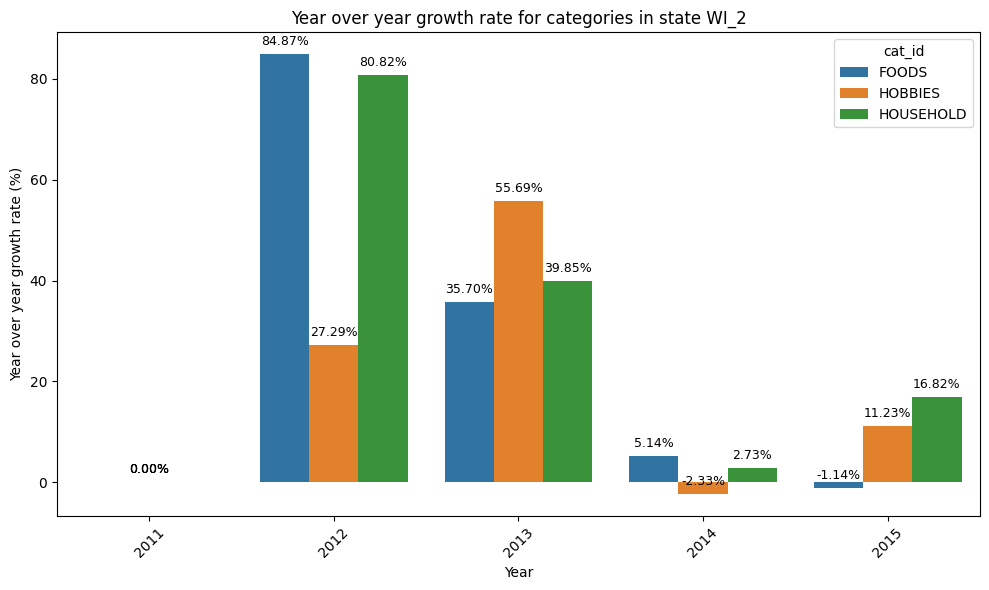

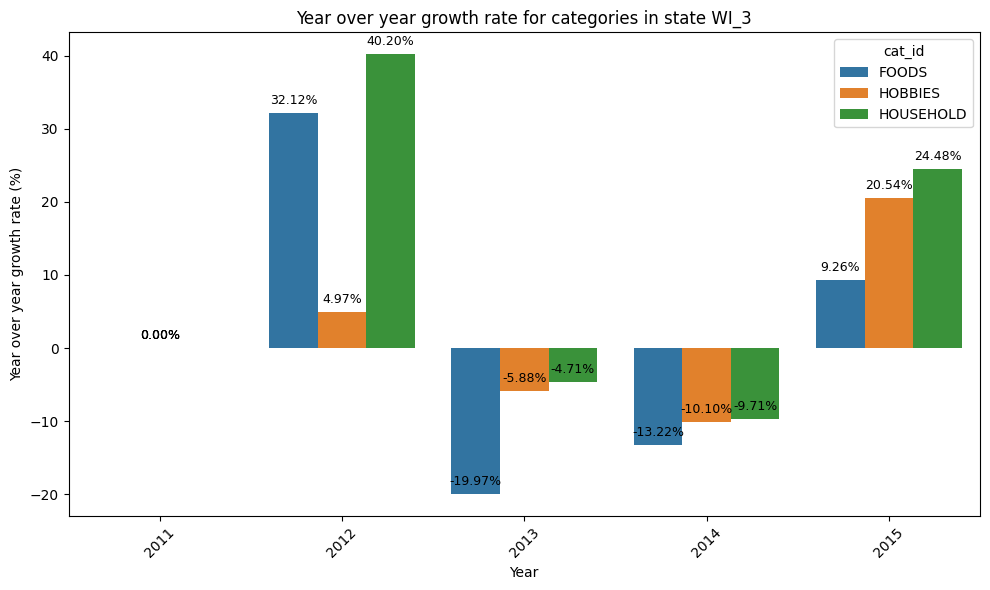

In [ ]:
# Visualization of YoY growth % via state
yoy_visualization(state_store_growth_rate_yearly,'store_id')

**Stores CA_1, CA_2, CA_3 and CA_4:**

* CA_1 remains positive overall, except for the decline in FOODS in 2014 and low growth in Hobbies in 2012.
* CA_2 experienced a significant decline in 2014, as shown in the state comparison plot.
* Foods and Hobbies show oscillating year-over-year growth for CA_3.
* Hobbies shows strong growth over the years, followed by Household in CA_4.


**Stores TX_1, TX_2 and TX_3:**

* In TX_1, Hobbies and Household have grown at a similar pace over the years, while Foods is the poorest performer.
* TX_2 saw significant struggles with growth in 2014.
* Growth across all categories is generally stable, except for the decline in 2014.

**Stores WI_1, WI_2 and WI_3:**

* Shows strong performance overall, aside from the initial negative growth in Hobbies in 2012.
* WI_2 experienced negative growth in 2013.
* Both WI_1 and WI_2 followed the typical negative growth pattern in 2014.

### 4.5 Calendar-based representation of demand for the Hobbies category in 2014

In [ ]:
from plotnine import * # ggplot plot library for visualization

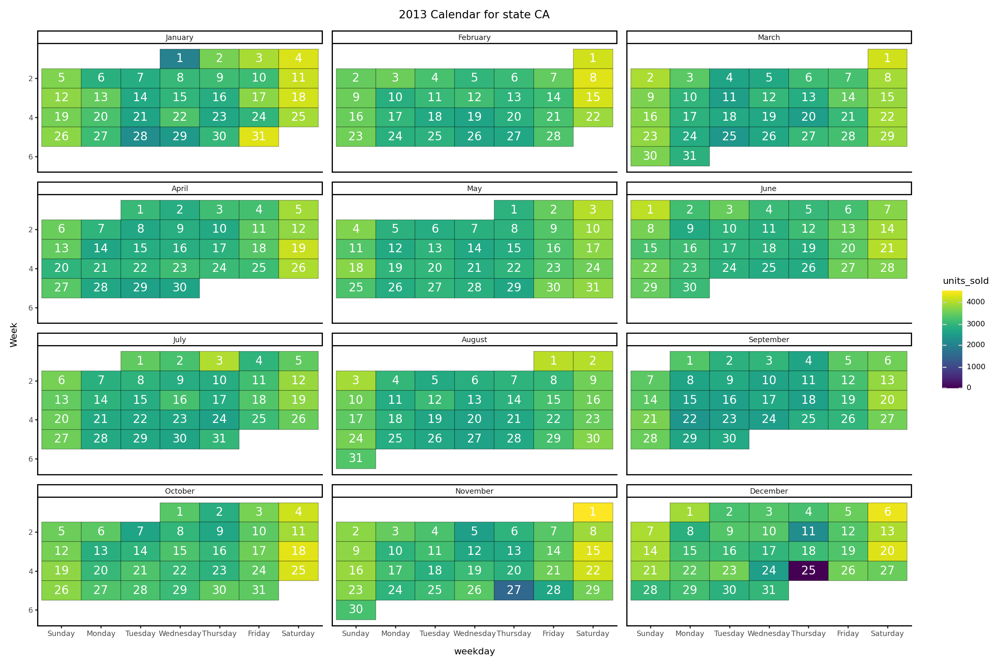

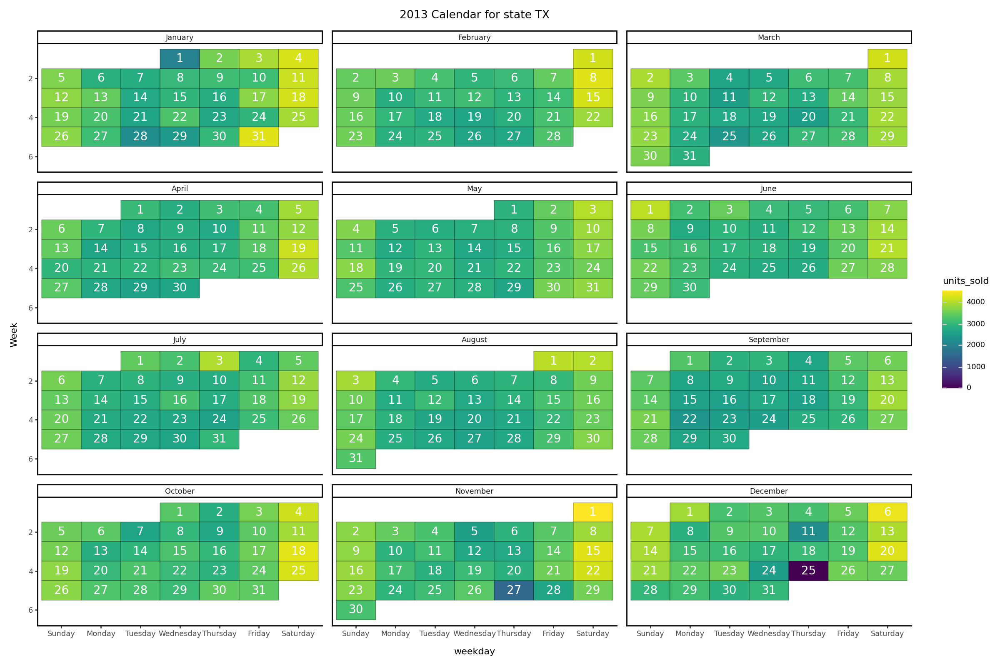

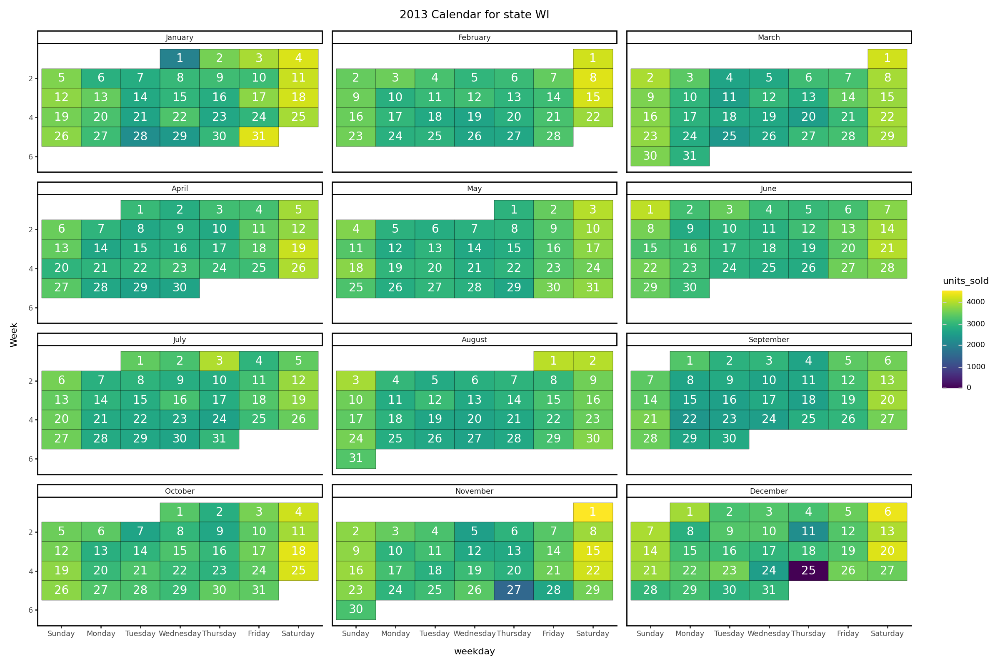

In [ ]:
"""
Date time features like Month, weekday, first_day_of_month, first_day_weekday, mday, month_start_offset, Month_week used
for the calendar heatmap.

ggplot() library plotnine is used for visualizing calendar heatmap.
"""

for state in train['state_id'].unique():
  hobbies_df = train[(train['state_id'] == state)]
  hobbies_df = train[(train['cat_id'] == 'HOBBIES') & (train['year'] == 2014)]
  hobbies_df = hobbies_df.groupby(['date'])['units_sold'].sum().reset_index()
  hobbies_df['Month'] = hobbies_df['date'].dt.strftime('%B')  # Full month name
  hobbies_df['weekday'] = hobbies_df['date'].dt.strftime('%A')  # Full weekday name
  hobbies_df['first_day_of_month'] = hobbies_df['date'].dt.to_period('M').apply(lambda x: x.start_time)
  hobbies_df['first_day_weekday'] = hobbies_df['first_day_of_month'].dt.weekday
  hobbies_df['mday'] = hobbies_df['date'].dt.day  # Day of the month
  hobbies_df['month_start_offset'] = (hobbies_df['first_day_weekday'] + 1) % 7
  hobbies_df['Month_week'] = (hobbies_df['mday'] + hobbies_df['month_start_offset'] - 1) // 7 + 1

  custom_day_order = ["Sunday","Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday"]

  hobbies_df['weekday'] = pd.Categorical(hobbies_df['weekday'], categories=custom_day_order, ordered=True)

  custom_month_order = ["January","February", "March", "April", "May", "June", "July","August","September","October","November","December"]
  hobbies_df['Month'] = pd.Categorical(hobbies_df['Month'], categories=custom_month_order, ordered=True)

  # Store the result in calendar_df
  calendar_df = hobbies_df

  # calendar heatmap using plotnine
  calendar_plot = (
      ggplot(calendar_df, aes(x='weekday', y='Month_week', fill='units_sold')) +
      geom_tile(color='black') +
      geom_text(aes(label='mday'), size=10, color='white') +
      facet_wrap('~Month', ncol=3) +
      theme_classic(base_size=8) +
      scale_y_continuous(breaks=np.arange(1, 6, 1)) +
      scale_y_reverse() +
      theme(legend_position="right",
            figure_size=(12, 8))+


            scale_fill_continuous()+
            labs(title=f"2013 Calendar for state {state}", y="Week", x=None)

  )

  print(calendar_plot)

Sales throughout the year by Calendar plot are represented by different color shades:

Yellow : Excess sales

Green: Average sales

Blue: Low Sales

* Weekends consistently show higher sales compared to weekdays. Sales typically start low during the early spring and fall months.
* November and December experience a significant dip due to store closures around Thanksgiving and Christmas.

### 4.6 Sales during Special events, holidays across CA, WI and TX

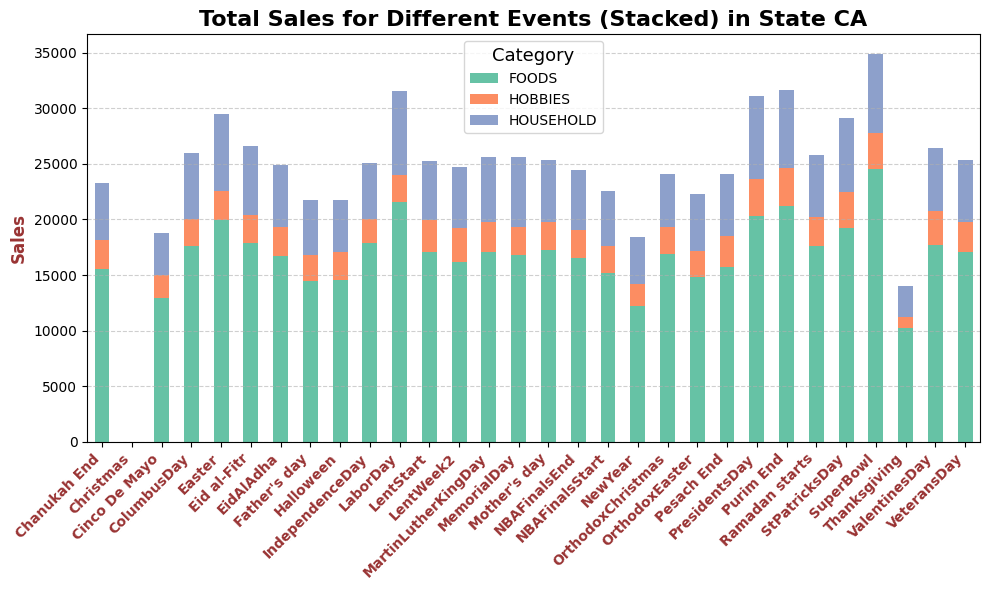

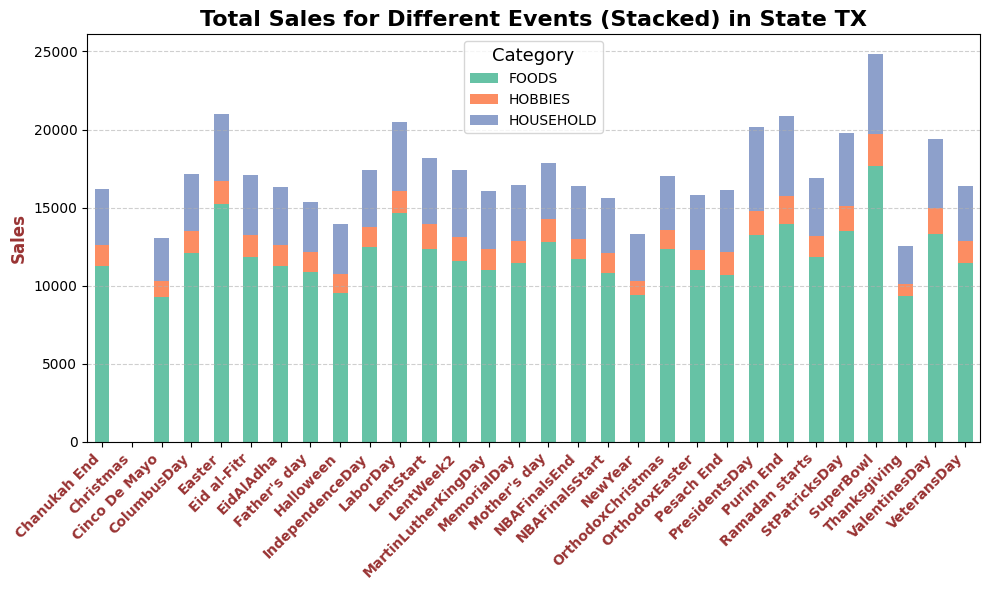

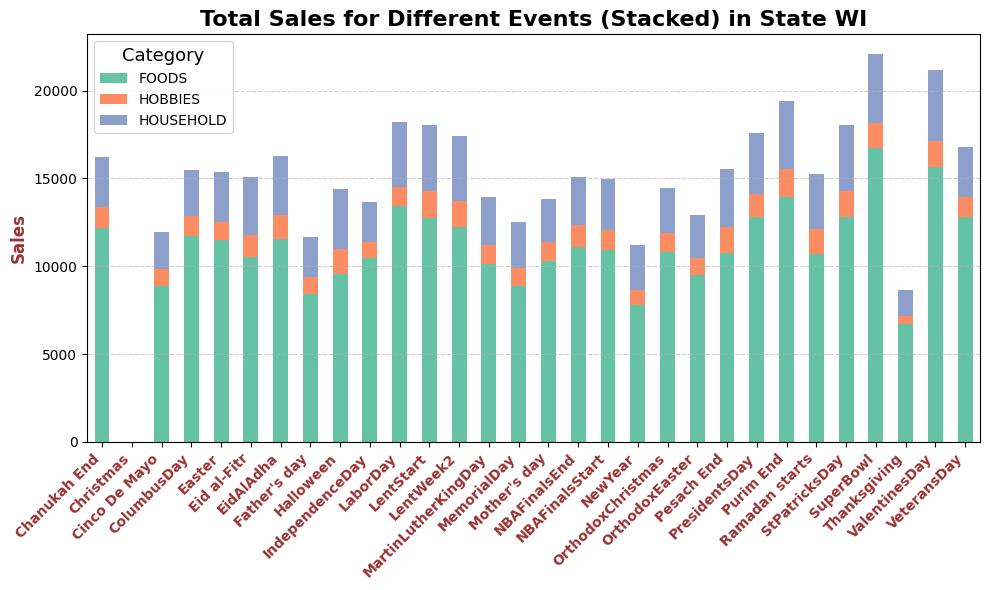

In [ ]:
"""
Sales during Special events, holidays across CA, WI and TX

Data being grouped by event, category and state and mean_sales being calculated.

Stacked bar chart is used for stacking categories FOODS, HOBBIES and HOUSEHOLD.
"""
events_name = train[~(train['event_name_1'].notna())]['event_name_1'].unique()
events_type = train[~(train['event_type_1'].notna())]['event_type_1'].unique()

for state in train['state_id'].unique():

  state_data = train[train['state_id'] == state]
  overall_data = state_data.groupby(['event_name_1', 'cat_id','state_id']).agg(
        mean_event_sales=('units_sold', 'sum')
    ).reset_index()
  overall_data['mean_event_sales'] = overall_data['mean_event_sales'].sort_values(ascending=False)


  pivot_df = overall_data.pivot_table(
        index='event_name_1', columns='cat_id', values='mean_event_sales', fill_value=0
    )

    # Plotting the Stacked Bar Chart
  pivot_df.plot(kind='bar', stacked=True, figsize=(10, 6), color=sns.color_palette('Set2'))


  plt.title(f"Total Sales for Different Events (Stacked) in State {state}", fontsize=16, fontweight='bold')
  plt.xlabel("")
  plt.ylabel("Sales", fontsize=12, color="#993333", fontweight='bold')
  plt.xticks(rotation=45, ha='right', fontsize=10, color="#993333", fontweight='bold')
  plt.legend(title='Category', title_fontsize='13')
  plt.grid(True, axis='y', linestyle='--', alpha=0.6)

  plt.tight_layout()
  plt.show()


* The FOODS category dominates sales across nearly all events, indicating that this category consistently generates the highest sales.
* HOBBIES contribute relatively less overall but see a significant spike around major events like Easter, SuperBowl, Labor's day, President and Purim's day.
* HOUSEHOLD shows moderate sales, contributing to each event but usually below FOODS.
* WI on the other hand sees sales on Valentine's day.
* Christmas sales are a drop across 3 states.

### 4.6 Different hierarchy levels for modelling

In [ ]:
# Extraction of week_number from column date
train['week_num'] = train['date'].dt.isocalendar().week

In [ ]:
def hierarchy_level(df,*col):
  col = list(col)
  df = df[~df['year'].isin([2016])]
  dfp = pd.pivot_table(data=df, index='week_num', columns='year',values='units_sold',aggfunc='sum')
  ax = dfp.plot(ylabel='Aggregated Sum', figsize=(13, 4), xticks=dfp.index)
  ax.legend(bbox_to_anchor=(1, 1.02), loc='upper left')
  if len(col) < 2:
    col1 = col[0]
    plt.title(f"Time series plot for {col1}")
  elif len(col) < 3:
    col1 = col[0]
    col2 = col[1]
    plt.title(f"Time series plot for {col1} and {col2}")
  else:
    col1 = col[0]
    col2 = col[1]
    col3 = col[2]
    plt.title(f"Time series plot for {col1} ,{col2} and {col3}")

  plt.show()

### Seasonal patterns across various hierarchical levels

### States Level: CA, TX and WI

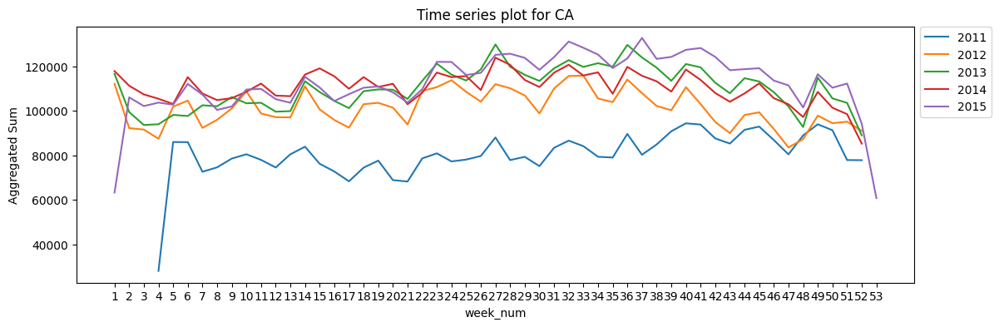

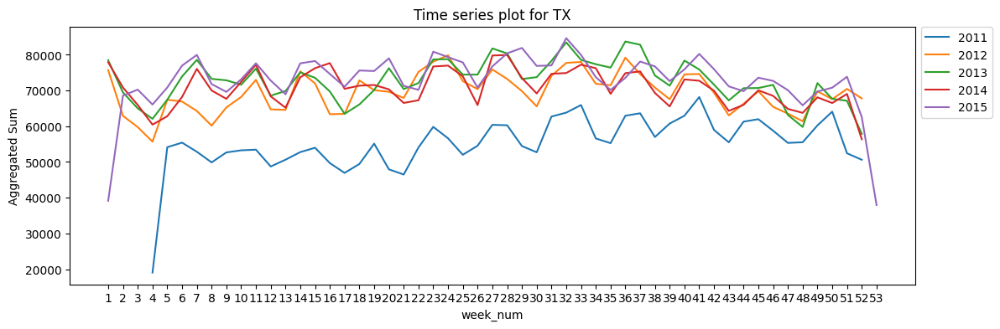

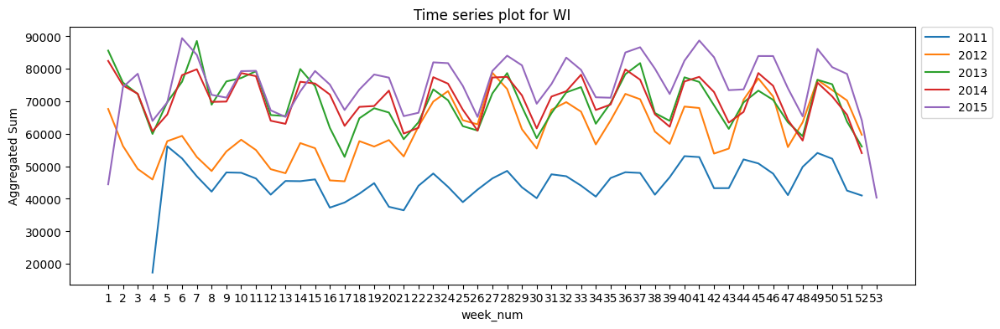

In [ ]:
for state in train['state_id'].unique():
  state_sales = train[(train['state_id'] == state)]
  hierarchy_level(state_sales,state)

Sales for year 2011 are low and we can notice an upward trend year over year with the highest in 2015. Seasonality is maintained across years and overall the data seems to be smooth at this level.

### State and Catgory level

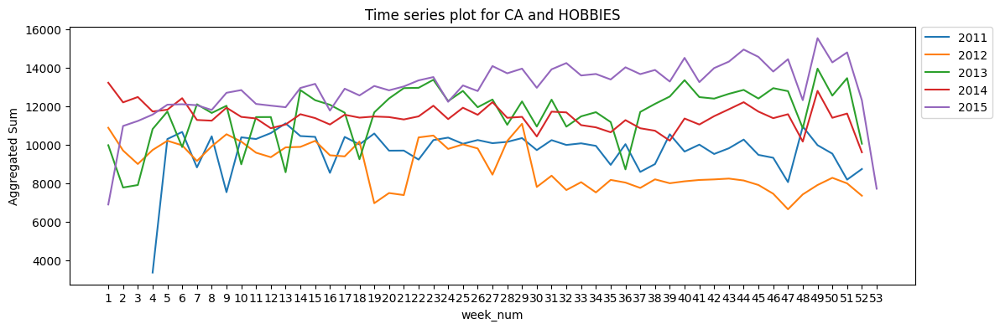

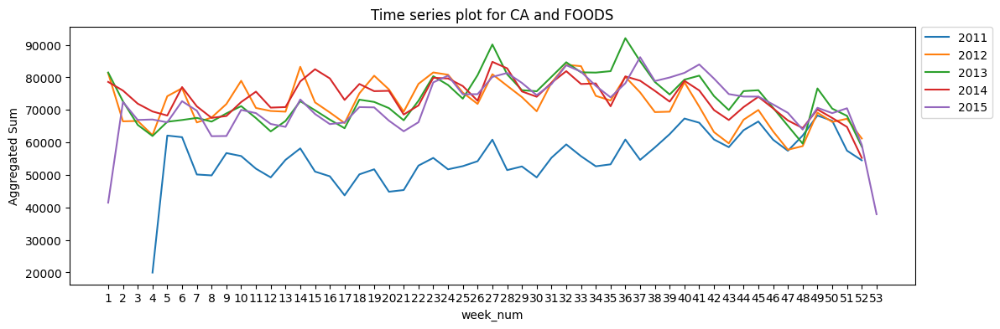

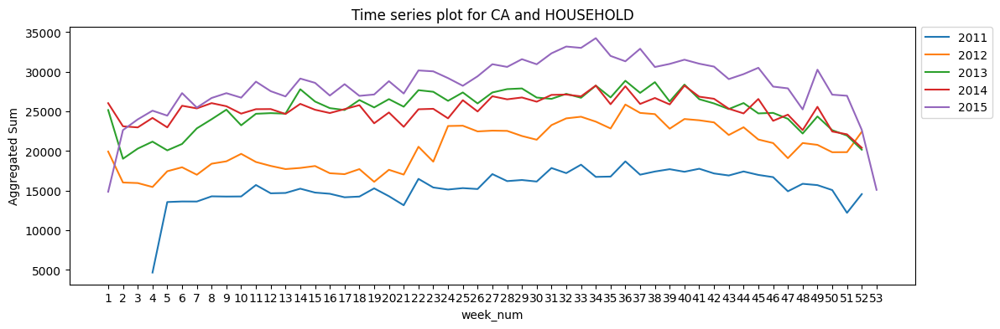

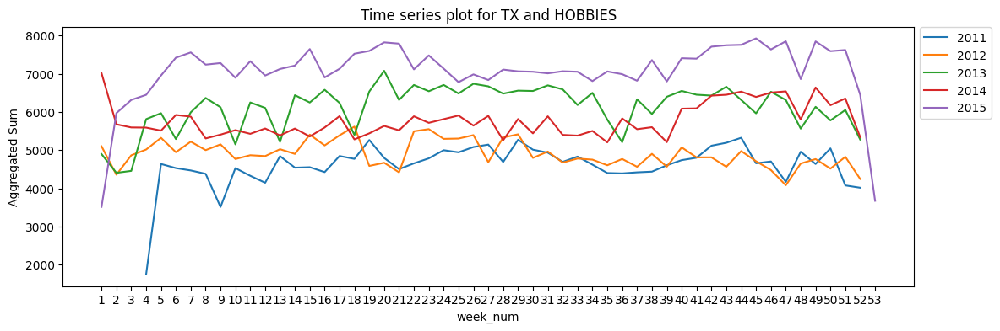

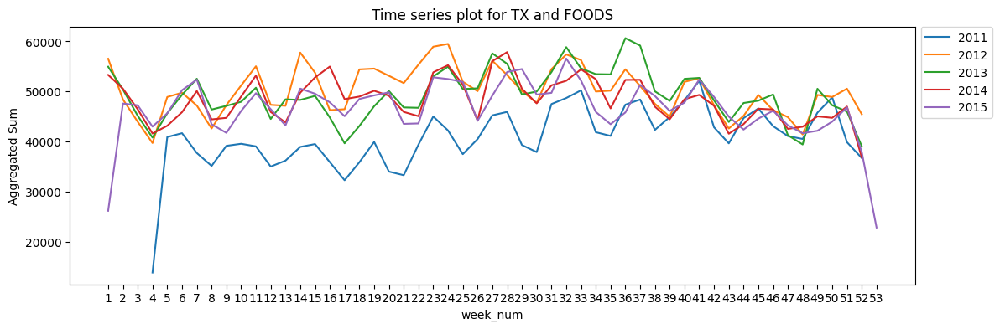

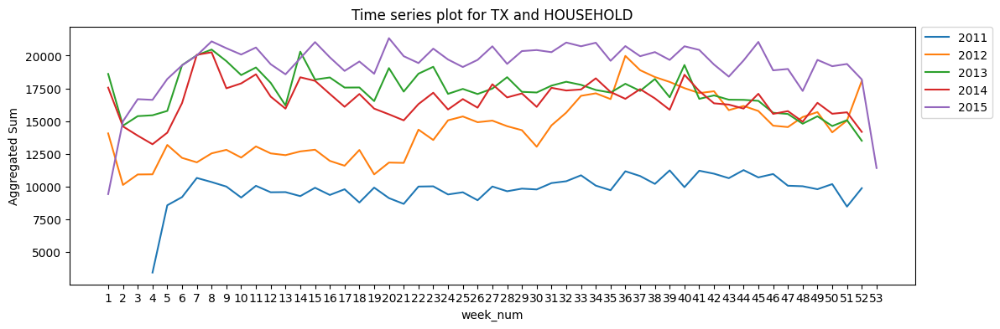

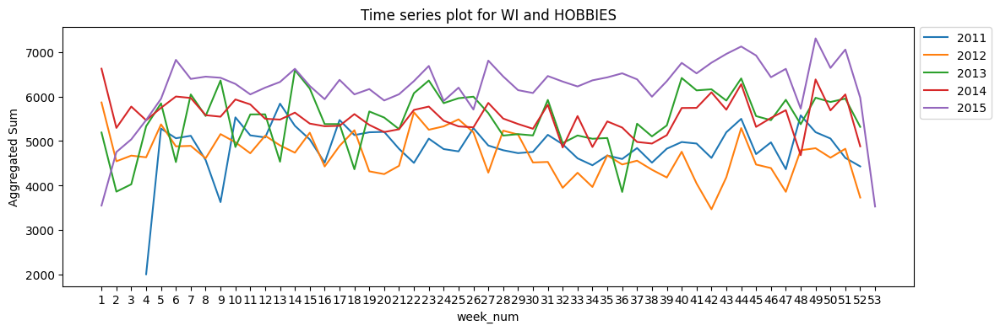

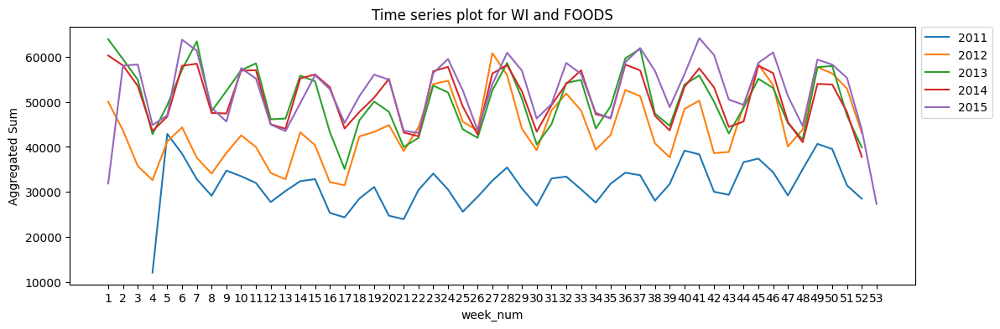

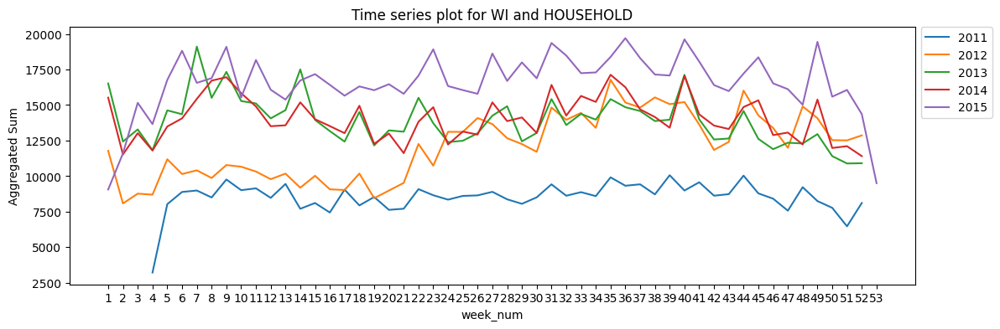

In [ ]:
for state, cat in product(train['state_id'].unique(),train['cat_id'].unique()):
  state_sales = train[(train['state_id'] == state) & (train['cat_id'] == cat)]
  hierarchy_level(state_sales,state,cat)

Trend and seasonality at lower level of state and category creates some noise, with seasonality in HOBBIES category getting distributed for 2012. HOUSEHOLD category also sees an increase in demand from 2nd quarter of 2012.

### Aggregation Level: Category and Store

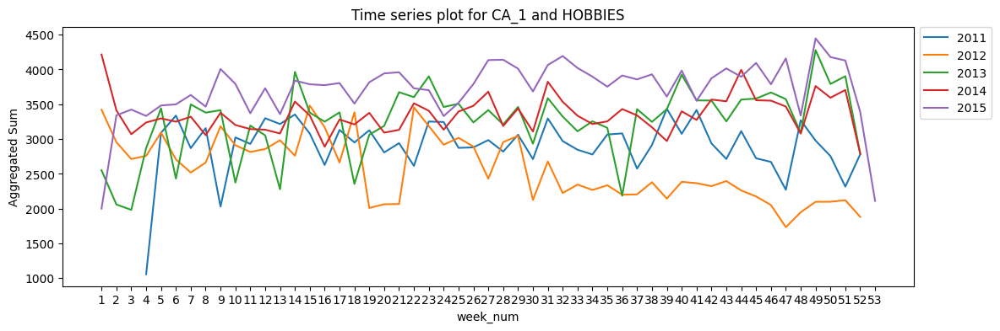

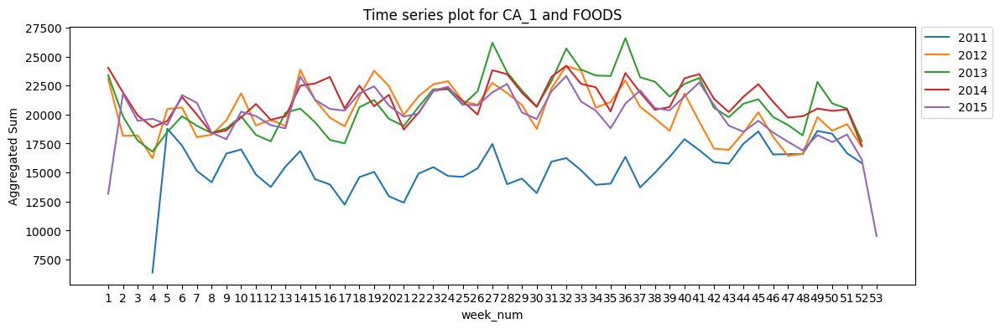

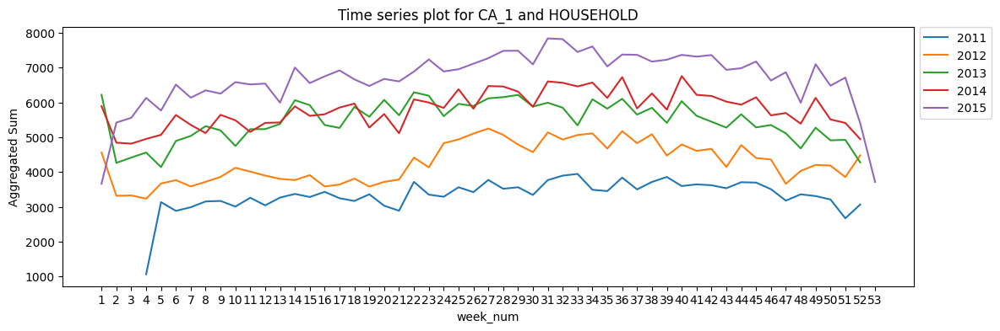

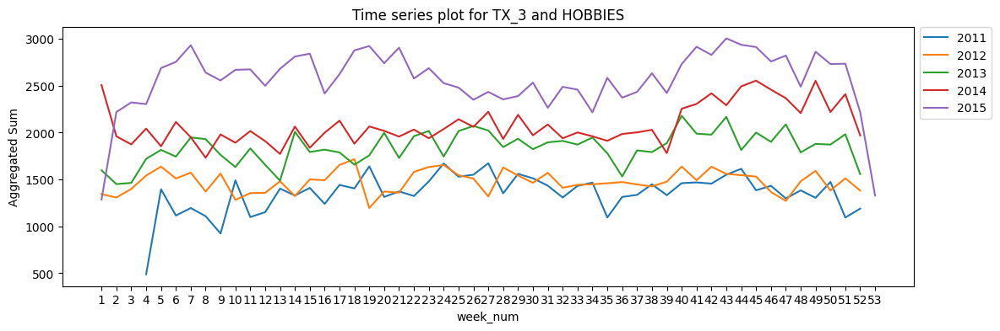

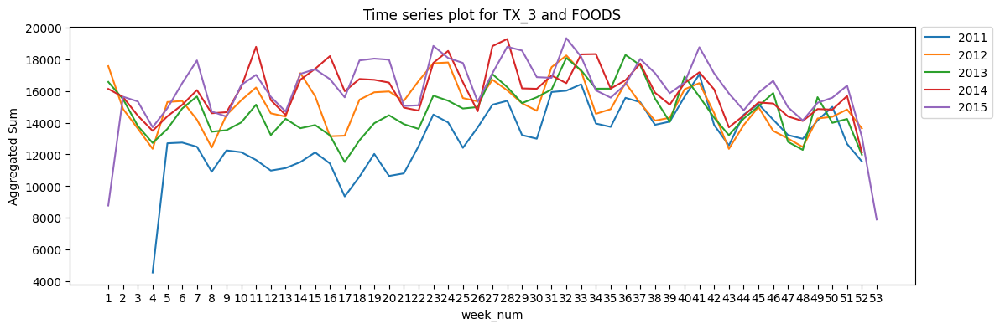

...

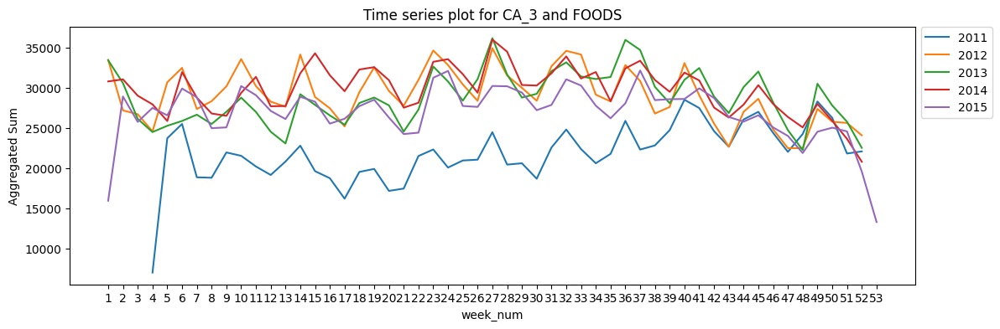

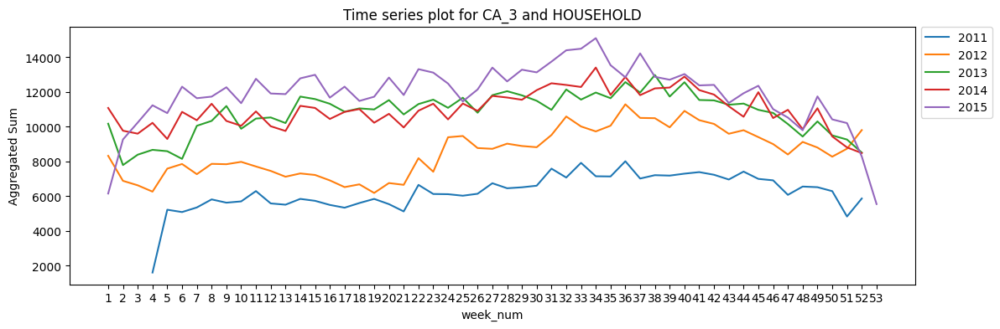

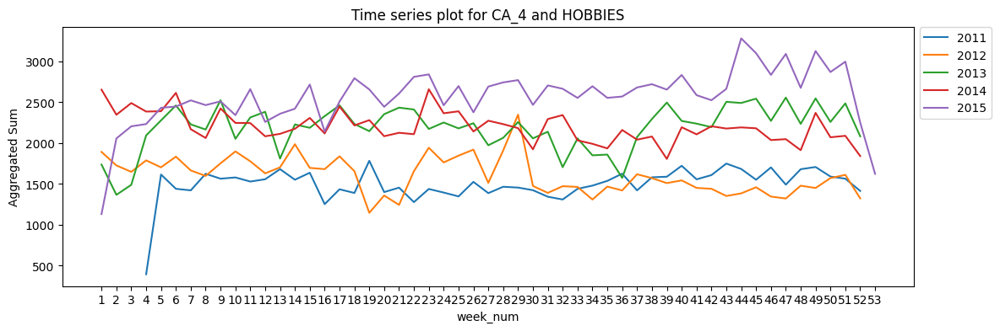

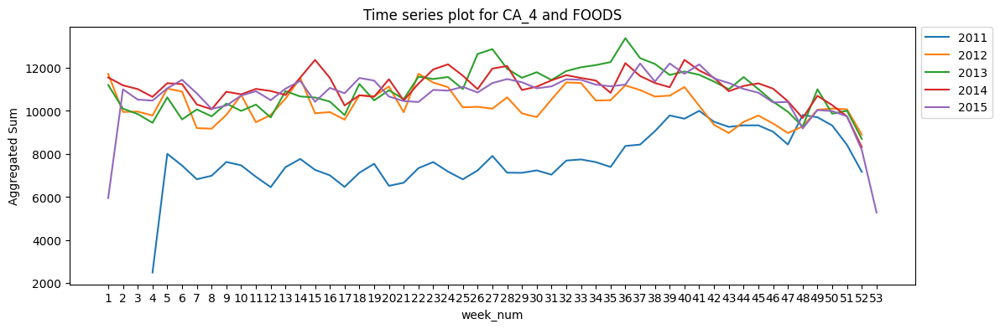

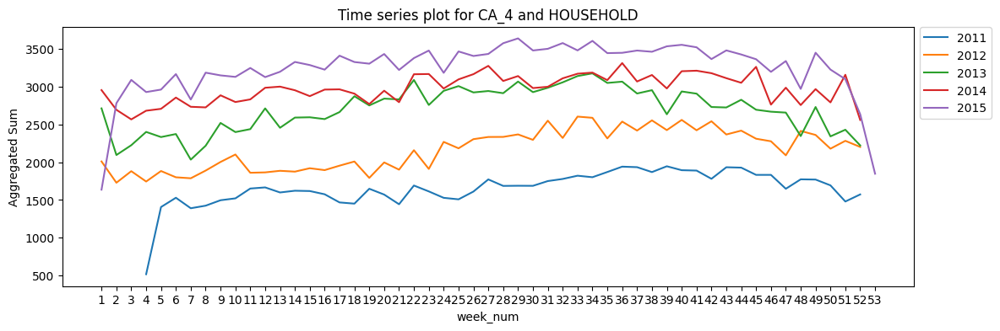

In [ ]:
for store, cat in product(train['store_id'].unique(),train['cat_id'].unique()):
  state_sales = train[(train['store_id'] == store) & (train['cat_id'] == cat)]
  hierarchy_level(state_sales,store,cat)

There are 30 combinations of data across store and category, the trend and seasonality is visible at a granular level with emphasis on which stores contribute to the down in sales at an aggregate level.

### Aggregate Level: Categories, Stores, Departments

In [ ]:
category_items = {
    'FOODS': ['FOODS_1', 'FOODS_2', 'FOODS_3'],
    'HOBBIES': ['HOBBIES_1', 'HOBBIES_2'],
    'HOUSEHOLD': ['HOUSEHOLD_1', 'HOUSEHOLD_2']
}
store_items = {
    'CA_1': category_items,
    'CA_2': category_items,
    'CA_3': category_items,
    'CA_4': category_items,
    'TX_1': category_items,
    'TX_2': category_items,
    'TX_3': category_items,
    'WI_1': category_items,
    'WI_2': category_items,
    'WI_3': category_items
}

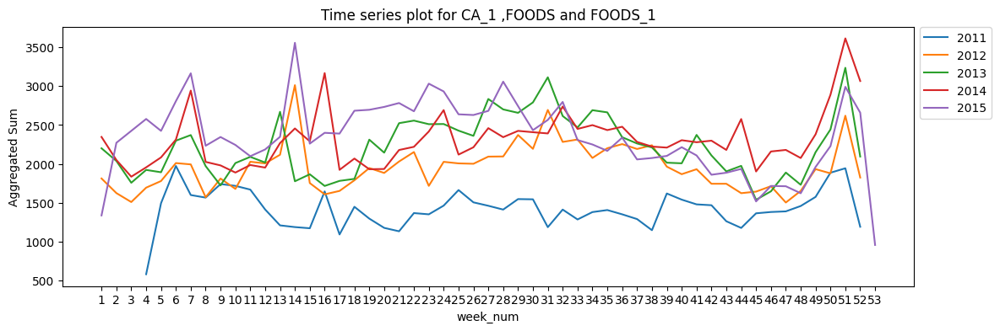

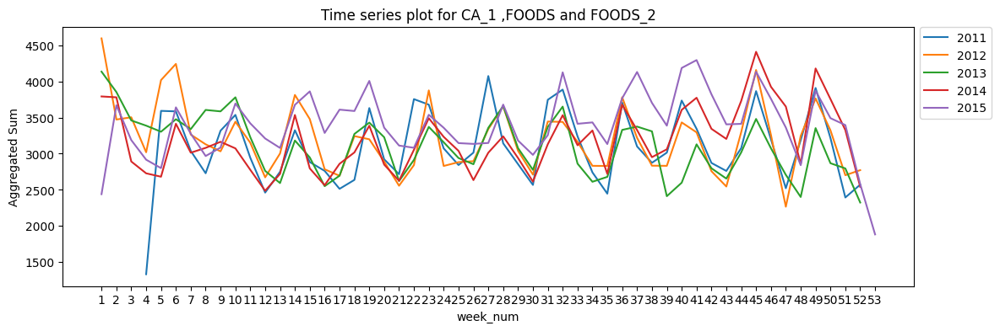

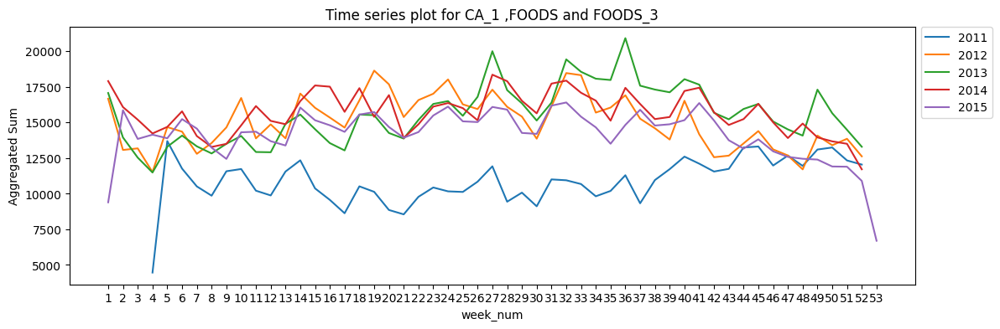

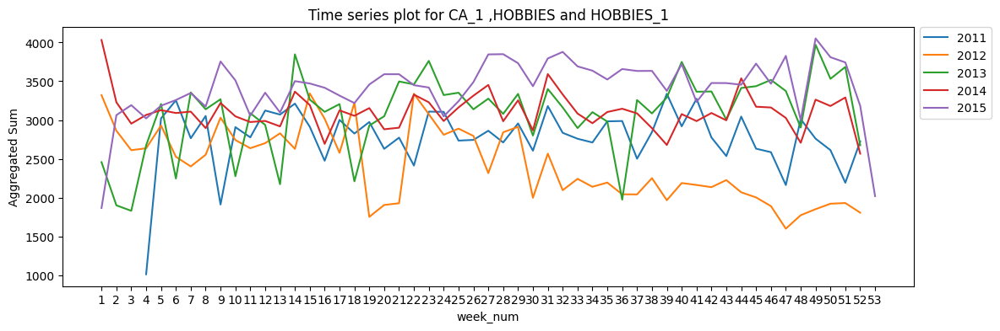

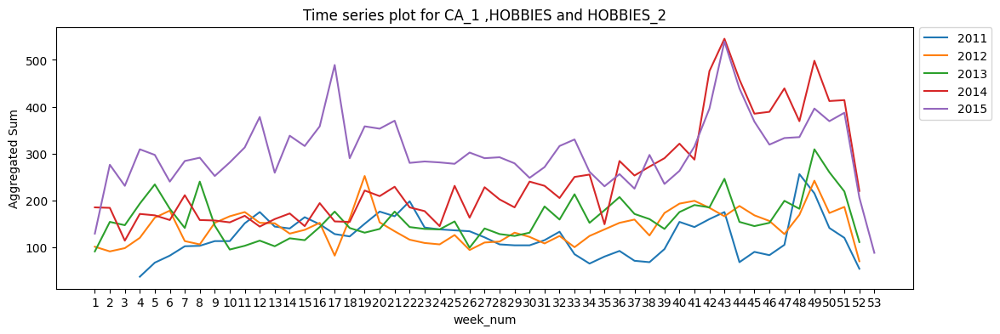

...

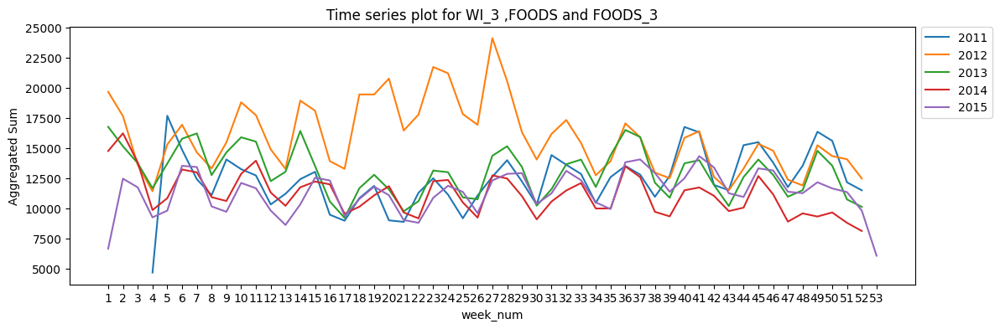

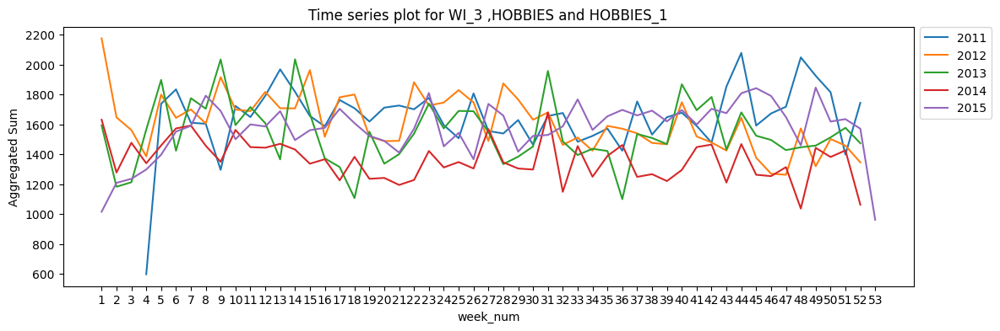

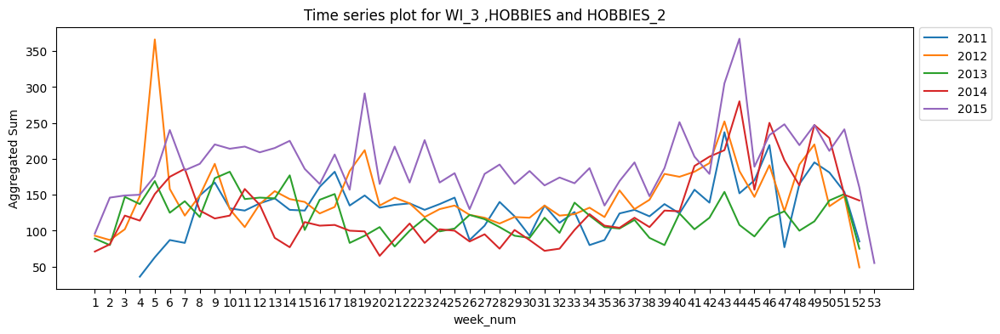

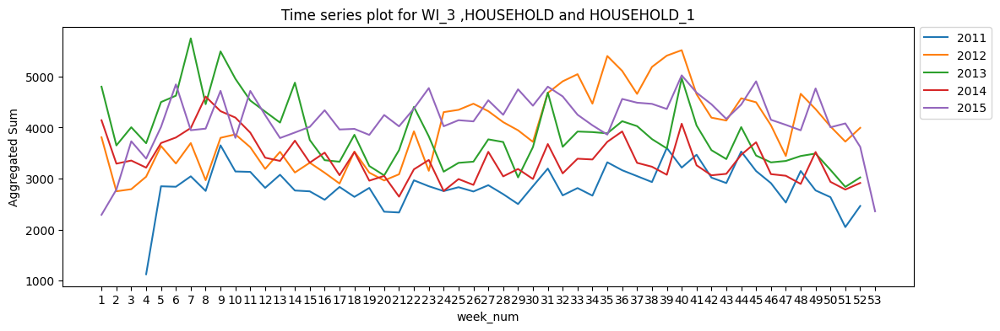

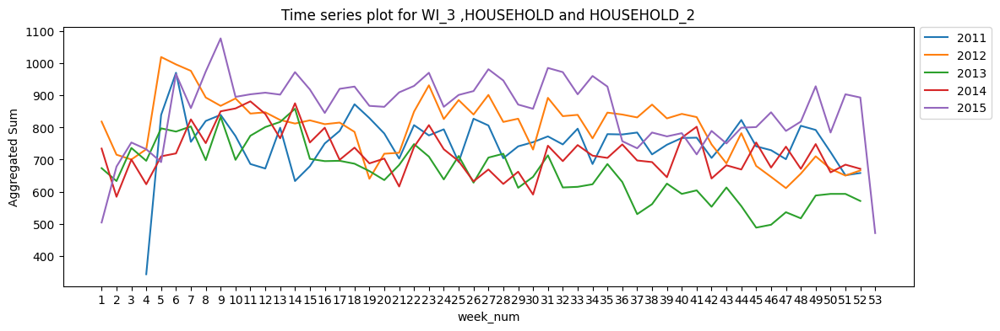

In [ ]:
for store, categories in store_items.items():
    for category, depts in categories.items():
      for dept in depts:
          state_sales = train[(train['store_id'] == store) & (train['cat_id'] == category) & (train['dept_id']==dept)]
          hierarchy_level(state_sales,store,category,dept)


There are around 120 combinations of category, foods and department. Looking at this level would be quite time taking at this level. However, in case of in-depth analysis diving down to this level would be beneficial.